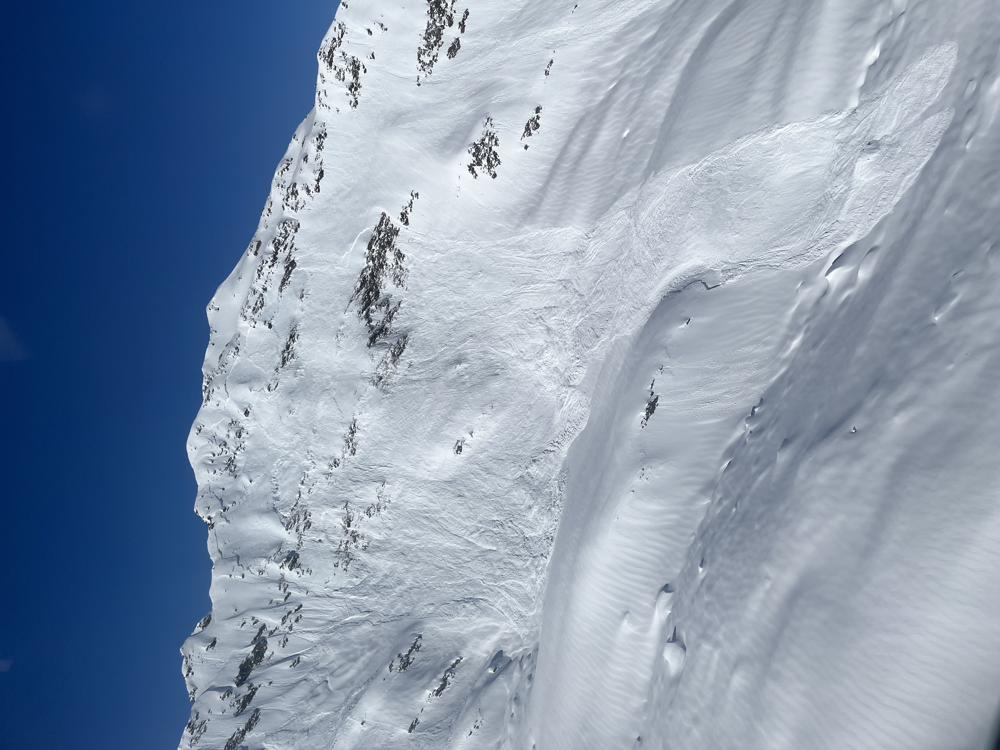

In [1]:
from IPython.display import Image

Image(filename="data/SLFPro Avalanches/20240304_PizzoFolcra.jpeg", width=300)


In [2]:
import cv2

img = cv2.imread('data/SLFPro Avalanches/20240304_PizzoFolcra.jpeg', cv2.IMREAD_GRAYSCALE)
edges = cv2.Sobel(img, cv2.CV_64F, 1, 1, ksize=3)


In [3]:
import numpy as np
import 
# Convert edges to absolute values
edges_abs = np.abs(edges)

# Calculate a threshold using Otsu's method on the normalized image
edges_norm = cv2.normalize(edges_abs, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
_, binary_edges = cv2.threshold(edges_norm, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
# Display the binary edges^
plt.figure(figsize=(12, 8))
plt.imshow(binary_edges, cmap='gray')
plt.axis('off')
plt.title('Binary Sobel Edges')
plt.show()

NameError: name 'plt' is not defined

In [4]:
import numpy as np

def find_horizon(binary_edges):
    height, width = binary_edges.shape
    horizon = np.zeros_like(binary_edges)
    
    # For each column, find the first white pixel from top
    horizon_points = []
    for x in range(width):
        col = binary_edges[:, x]
        white_pixels = np.where(col == 255)[0]
        if len(white_pixels) > 0:
            horizon_points.append((x, white_pixels[0]))
    
    # If we have enough points, connect them
    if len(horizon_points) > width * 0.7:  # At least 70% of width should have points
        for i in range(len(horizon_points)-1):
            x1, y1 = horizon_points[i]
            x2, y2 = horizon_points[i+1]
            # Draw line between consecutive points
            cv2.line(horizon, (x1, y1), (x2, y2), 255, 1)
    
    return horizon

# Find and display the horizon
horizon = find_horizon(binary_edges)

# Display original edges and horizon
plt.figure(figsize=(15, 5))

plt.subplot(121)
plt.imshow(binary_edges, cmap='gray')
plt.title('Binary Edges')
plt.axis('off')

plt.subplot(122)
plt.imshow(horizon, cmap='gray')
plt.title('Extracted Horizon')
plt.axis('off')

plt.tight_layout()
plt.show()

NameError: name 'plt' is not defined

In [5]:
def find_smooth_horizon(binary_edges):
    height, width = binary_edges.shape
    horizon = np.zeros_like(binary_edges)
    
    # Parameters for smoothing
    max_vertical_jump = 20  # Maximum allowed vertical difference between adjacent points
    window_size = 15  # Size of smoothing window
    
    # Find initial points
    horizon_points = []
    prev_y = None
    
    # First pass: collect points with vertical constraint
    for x in range(width):
        col = binary_edges[:, x]
        white_pixels = np.where(col == 255)[0]
        
        if len(white_pixels) > 0:
            current_y = white_pixels[0]
            
            # Apply vertical constraint
            if prev_y is not None:
                if abs(current_y - prev_y) > max_vertical_jump:
                    # If jump is too large, interpolate
                    current_y = prev_y + np.sign(current_y - prev_y) * max_vertical_jump
            
            horizon_points.append((x, current_y))
            prev_y = current_y
    
    # Second pass: smooth the line using moving average
    if len(horizon_points) > window_size:
        smoothed_points = []
        y_values = [p[1] for p in horizon_points]
        
        # Pad the edges to handle boundaries
        pad_left = y_values[:window_size][::-1]
        pad_right = y_values[-window_size:][::-1]
        padded_y = np.concatenate([pad_left, y_values, pad_right])
        
        # Apply moving average
        for i in range(len(horizon_points)):
            start_idx = i + window_size
            window = padded_y[start_idx - window_size//2:start_idx + window_size//2 + 1]
            smoothed_y = int(np.mean(window))
            smoothed_points.append((horizon_points[i][0], smoothed_y))
        
        # Draw the smoothed line
        for i in range(len(smoothed_points)-1):
            x1, y1 = smoothed_points[i]
            x2, y2 = smoothed_points[i+1]
            cv2.line(horizon, (x1, y1), (x2, y2), 255, 1)
    
    return horizon

# Find and display the smoothed horizon
smooth_horizon = find_smooth_horizon(binary_edges)

# Display original edges and horizon
plt.figure(figsize=(15, 5))

plt.subplot(121)
plt.imshow(binary_edges, cmap='gray')
plt.title('Binary Edges')
plt.axis('off')

plt.subplot(122)
plt.imshow(smooth_horizon, cmap='gray')
plt.title('Smoothed Horizon')
plt.axis('off')

plt.tight_layout()
plt.show()

NameError: name 'plt' is not defined

In [6]:
# Read the original image in color this time
img_color = cv2.imread('data/SLFPro Avalanches/20240304_PizzoFolcra.jpeg')
img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for matplotlib

# Create a copy of the color image to draw on
img_with_horizon = img_color.copy()

# Find the horizon points
horizon_points = np.where(smooth_horizon == 255)
for x, y in zip(horizon_points[1], horizon_points[0]):
    cv2.circle(img_with_horizon, (x, y), 5, (255, 0, 0), 2)  # Draw red points

# Display the result
plt.figure(figsize=(15, 10))
plt.imshow(img_with_horizon)
plt.title('Original Image with Horizon Line')
plt.axis('off')
plt.show()

NameError: name 'plt' is not defined

In [7]:
def find_horizon_with_neighborhood(binary_edges):
    height, width = binary_edges.shape
    horizon = np.zeros_like(binary_edges)
    
    def find_next_in_neighborhood(current_x, current_y):
        # Define 7x7 neighborhood bounds
        start_y = max(0, current_y - 3)
        end_y = min(height, current_y + 4)
        next_x = current_x + 1
        
        if next_x >= width:
            return None, None
        
        # Search in 7x7 neighborhood for next edge pixel
        neighborhood = binary_edges[start_y:end_y, next_x]
        edge_pixels = np.where(neighborhood == 255)[0]
        
        if len(edge_pixels) > 0:
            # Find the closest edge pixel to current_y in the neighborhood
            local_y = edge_pixels[np.argmin(np.abs(edge_pixels + start_y - current_y))]
            return next_x, local_y + start_y
        
        return None, None
    
    def trace_path_from_start(start_y):
        path = [(0, start_y)]
        current_x, current_y = 0, start_y
        
        while current_x is not None:
            next_x, next_y = find_next_in_neighborhood(current_x, current_y)
            if next_x is not None:
                path.append((next_x, next_y))
                current_x, current_y = next_x, next_y
            else:
                break
        
        # Check if path spans the full width
        if len(path) > 0 and path[-1][0] == width - 1:
            return path
        return None
    
    # Get all edge pixels in the first column
    first_column_edges = np.where(binary_edges[:, 0] == 255)[0]
    
    # Try each starting point until we find a valid path
    for start_y in first_column_edges:
        path = trace_path_from_start(start_y)
        if path is not None:
            # Draw the path
            for i in range(len(path) - 1):
                x1, y1 = path[i]
                x2, y2 = path[i + 1]
                cv2.line(horizon, (x1, y1), (x2, y2), 255, 1)
            return horizon
    
    return horizon

# Find and display the horizon
horizon = find_horizon_with_neighborhood(binary_edges)

# Display results
plt.figure(figsize=(15, 10))

# Original image with horizon overlay
img_color = cv2.imread('data/SLFPro Avalanches/20240304_PizzoFolcra.jpeg')
img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
img_with_horizon = img_color.copy()

# Draw horizon in red
horizon_points = np.where(horizon == 255)
for x, y in zip(horizon_points[1], horizon_points[0]):
    cv2.circle(img_with_horizon, (x, y), 5, (255, 0, 0), 2)

plt.imshow(img_with_horizon)
plt.title('Original Image with Extracted Horizon')
plt.axis('off')
plt.show()

NameError: name 'plt' is not defined

In [42]:
np.unique(horizon)

array([0], dtype=uint8)

In [8]:
def find_horizon_with_neighborhood(binary_edges):
    height, width = binary_edges.shape
    horizon = np.zeros_like(binary_edges)
    
    def find_next_in_neighborhood(current_x, current_y, search_width=3):
        # Define neighborhood bounds with wider search area
        start_y = max(0, current_y - 3)
        end_y = min(height, current_y + 4)
        start_x = min(width, current_x + 1)
        end_x = min(width, current_x + 1 + search_width)
        
        if start_x >= width:
            return None, None
            
        # Search in neighborhood for next edge pixel
        neighborhood = binary_edges[start_y:end_y, start_x:end_x]
        if neighborhood.size == 0:
            return None, None
            
        # Find any edge pixels in the neighborhood
        edge_y, edge_x = np.where(neighborhood == 255)
        if len(edge_y) > 0:
            # Find the closest edge pixel to current_y
            distances = np.abs(edge_y + start_y - current_y)
            closest_idx = np.argmin(distances)
            return start_x + edge_x[closest_idx], edge_y[closest_idx] + start_y
            
        return None, None
    
    def trace_path_from_start(start_y):
        path = [(0, start_y)]
        current_x, current_y = 0, start_y
        failed_searches = 0
        
        while current_x is not None and current_x < width - 2:
            # Try with increasing search width if we can't find next pixel
            for search_width in [3, 5, 7]:
                next_x, next_y = find_next_in_neighborhood(current_x, current_y, search_width)
                if next_x is not None:
                    path.append((next_x, next_y))
                    current_x, current_y = next_x, next_y
                    failed_searches = 0
                    break
            else:
                failed_searches += 1
                if failed_searches > 3:  # Allow some gaps
                    break
                # If no pixel found, continue in same direction
                next_x = min(width - 1, current_x + 1)
                path.append((next_x, current_y))
                current_x, current_y = next_x, current_y
        
        # Check if path spans at least 90% of the width
        if len(path) > 0 and path[-1][0] >= width * 0.9:
            return path
        return None
    
    # Get all edge pixels in the second column (first column has no edges)
    first_column_edges = np.where(binary_edges[:, 1] == 255)[0]
    
    # Debug: print number of starting points
    print(f"Found {len(first_column_edges)} potential starting points")
    
    # Try each starting point until we find a valid path
    for start_y in first_column_edges:
        path = trace_path_from_start(start_y)
        if path is not None:
            # Draw the path
            for i in range(len(path) - 1):
                x1, y1 = path[i]
                x2, y2 = path[i + 1]
                cv2.line(horizon, (x1, y1), (x2, y2), 255, 1)
            print(f"Found valid path starting at y={start_y}")
            return horizon
    
    print("No valid path found")
    return horizon

# Let's also check if we need to adjust the edge detection
plt.figure(figsize=(15, 10))

plt.subplot(121)
plt.imshow(binary_edges, cmap='gray')
plt.title('Binary Edges')
plt.axis('off')

# Find and display the horizon
horizon = find_horizon_with_neighborhood(binary_edges)

# Original image with horizon overlay
img_color = cv2.imread('data/SLFPro Avalanches/20240304_PizzoFolcra.jpeg')
img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
img_with_horizon = img_color.copy()

# Draw horizon in red
horizon_points = np.where(horizon == 255)
for x, y in zip(horizon_points[1], horizon_points[0]):
    cv2.circle(img_with_horizon, (x, y), 1, (255, 0, 0), 2)

plt.subplot(122)
plt.imshow(img_with_horizon)
plt.title('Image with Horizon (if found)')
plt.axis('off')

plt.tight_layout()
plt.show()

NameError: name 'plt' is not defined

In [ ]:
# todo: edge detection funktioniert grad net, ich vermute es liegt daran dass ein paar sprünge in den kanten sind vong 0 und 1 her und ganz an den rändern zb ist alles 0 wg sobel edge detection
# lieber einfach column von oben nach unten durchgehen und das erste mit 1 holen

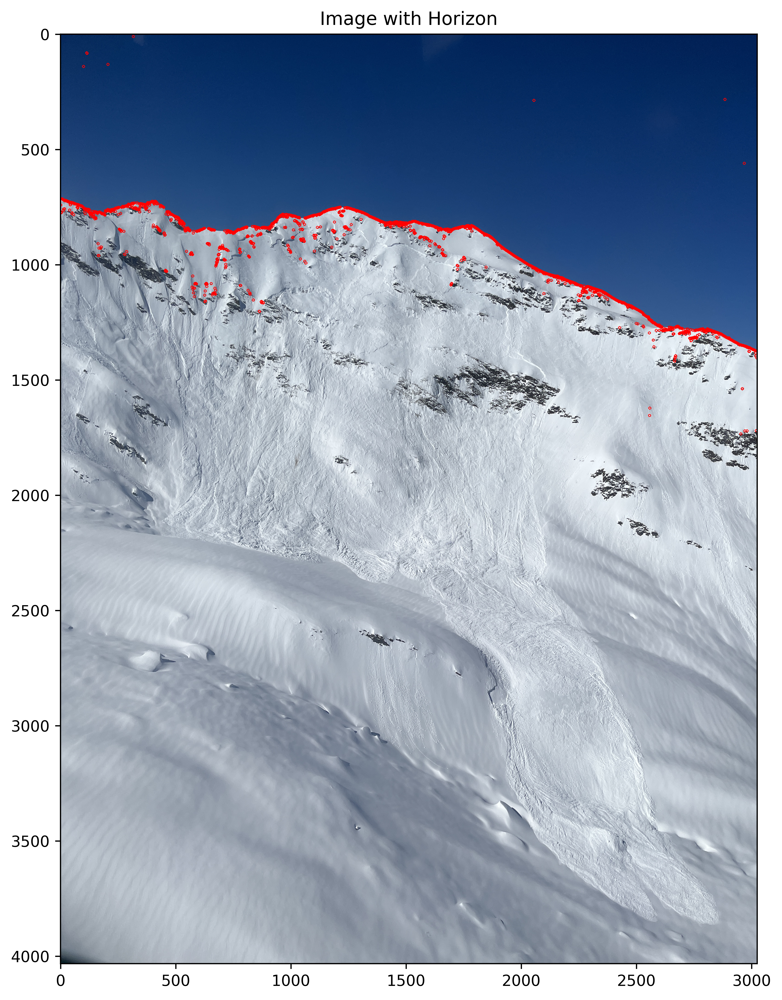

In [78]:
def detect_horizon(binary_edges):
    horizon = np.zeros_like(binary_edges)
    for x in range(binary_edges.shape[1]):
        for y in range(binary_edges.shape[0]):
            if binary_edges[y, x] != 0:
                horizon[y, x] = 255
                break
    return horizon

# Find and display the horizon
horizon = detect_horizon(binary_edges)

# Original image with horizon overlay
img_color = cv2.imread('data/SLFPro Avalanches/20240304_PizzoFolcra.jpeg')
img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
img_with_horizon = img_color.copy()

# Draw horizon in red
horizon_points = np.where(horizon == 255)
for x, y in zip(horizon_points[1], horizon_points[0]):
    cv2.circle(img_with_horizon, (x, y), 5, (255, 0, 0), 2)


plt.figure(figsize=(18, 12), dpi=600)
plt.subplot(122)
plt.imshow(img_with_horizon)
plt.title('Image with Horizon')
plt.show()

# horizon line not perfect bc thresholding not perfect, would have to look at line with otsus

In [ ]:
# ray tracing ding:
# wir haben camera position, abrisskante, avalanche polygon, brennweite, azimuth. roll und pitch mal 0 annehmen oder paar werte ausprobieren sodass die berechnung des abrisspunktes am besten passt.
# 

In [94]:
plt.figure(figsize=(18, 12), dpi=600)

import matplotlib.pyplot as plt

plt.imsave('data/SLFPro Avalanches/binary_edges.png', binary_edges, cmap='gray', dpi=600)
plt.imsave('data/SLFPro Avalanches/abs_sobel_edges.png', edges_abs, cmap='gray', dpi=600)
plt.imsave('data/SLFPro Avalanches/abs_sobel_clip_edges.png', np.clip(30*edges_abs, 0, 255), cmap='gray', dpi=600)



<Figure size 10800x7200 with 0 Axes>

In [91]:
np.unique(np.clip(255*edges_abs, 0, 255))

array([  0., 255.])

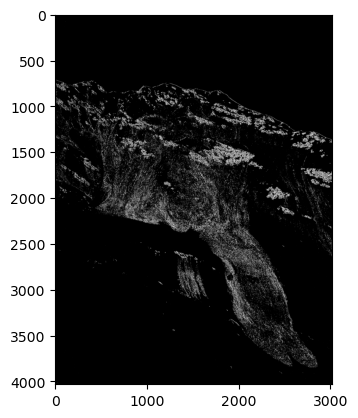

In [84]:
plt.imshow(np.abs(binary_edges), cmap='gray')


### Render DEM
For some reason pyvista crashes in my conda environment for this project (Python 3.11 I think). But it works in my base conda environment with Python 3.12.7

### 1. Load DEM

In [1]:
import numpy as np

def load_dem(file_path):
    """
    Load the DEM file in X, Y, Z ASCII format.
    Skips the header row ("X Y Z").
    Returns arrays of X, Y, Z.
    """
    # Load the data while skipping the first row
    data = np.loadtxt(file_path, skiprows=1)
    x = data[:, 0]  # First column: X values
    y = data[:, 1]  # Second column: Y values
    z = data[:, 2]  # Third column: Z values
    return x, y, z

# Example usage
file_path = "data/SLFPro Avalanches/DEM-pizzo-folcra-avalanche-SWISSALTI3D_0.5_XYZ_CHLV95_LN02_2684_1148.xyz"
x, y, z = load_dem(file_path)
print("Loaded DEM data:", x.shape, y.shape, z.shape)


Loaded DEM data: (4000000,) (4000000,) (4000000,)


### 2. Create 3D mesh

In [2]:
import pyvista as pv

# Create a structured grid if X, Y form a grid
grid = pv.StructuredGrid()
grid.points = np.column_stack((x, y, z))
grid.dimensions = (len(np.unique(x)), len(np.unique(y)), 1)  # Adjust based on your grid layout

### 3. Set up camera

In [3]:
# transform latitude (8.541944000) and longitude (46.478333000) to LV95: https://www.swisstopo.admin.ch/de/koordinaten-konvertieren-navref
camera_x = 2684726.785
camera_y = 1148040.781
# altitude from digital elevation map + 1-2 m because the camera is held by a person above the ground
camera_z = 2300#2285


focal_length = 5.1 # in mm?

# angles in degrees
pitch = 0 # assumption
roll = 0 # assumption
yaw = 359.86181640625 # from exif data

In [4]:
from scipy.spatial.transform import Rotation as R

# Assuming you already have camera_x, camera_y, camera_z, roll, pitch, yaw, and focal_length
# First, define the camera's position
camera_position = (camera_x, camera_y, camera_z)

# Compute the rotation matrix from the pitch, yaw, and roll
rotation = R.from_euler('xyz', [pitch, yaw, roll], degrees=True).as_matrix()

# Get the forward direction (this is the direction the camera is looking at)
forward_direction = rotation[:, 2]  # This is typically the third column (Z-axis in camera space)

# We don't need a focal point anymore, but we can set a point in front of the camera based on its direction
look_at = camera_position + forward_direction * 100  # Adjust the distance as needed (e.g., 100 units ahead)

# Now we can set up the camera without focal_point, just using the position and forward direction
camera = pv.Camera()
camera.position = camera_position
camera.view_up = rotation[:, 1]  # Set the 'up' direction based on the Y-axis of the rotation matrix

# Adjust the camera to look towards the `look_at` point (this replaces using a focal_point)
#camera.view_angle = 45  # Optional: Set a specific field of view angle
#camera.parallel_scale = focal_length  # For orthographic projection


### 4. Render the scene

In [5]:
plotter = pv.Plotter()
plotter.add_mesh(grid, cmap="terrain")  # Add your grid mesh with a colormap
plotter.camera = camera  # Apply your custom camera
plotter.show()  # Show the plot


Widget(value='<iframe src="http://localhost:60860/index.html?ui=P_0x331102060_0&reconnect=auto" class="pyvista…